[View in Colaboratory](https://colab.research.google.com/github/ChrisSto37/geopy/blob/master/AcqProcCourse.ipynb)

# **Introduction to Seismic Acquisition and Processing - Exercises¶**
**Christian Stotter, HOT Engineering**


##Pre-requesites

**First we import required libraries**

In [0]:
import scipy.signal as sign
from scipy.fftpack import fft, fftshift
import math
import numpy as np
from numpy import sin, cos
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import Image
from IPython.core.display import HTML 
import warnings
warnings.filterwarnings("ignore")

**Then we need a function to display seismic wiggle traces in VA mode
This we borrowed from Agile *Geoscience* **

In [0]:
def plot_vawig(axhdl, data, t, excursion, highlight=None):
    import numpy as np
    import matplotlib.pyplot as plt
    [ntrc, nsamp] = data.shape
    
    t = np.hstack([0, t, t.max()])
    
    for i in range(0, ntrc):
        tbuf = excursion * data[i] / np.max(np.abs(data)) + i
        tbuf = np.hstack([i, tbuf, i])
        if i==highlight:
            lw = 2
        else:
            lw = 0.5
        axhdl.plot(tbuf, t, color='black', linewidth=lw)
        plt.fill_betweenx(t, tbuf, i, where=tbuf>i, facecolor=[0.6,0.6,1.0], 
                          linewidth=0)
        plt.fill_betweenx(t, tbuf, i, where=tbuf<i, facecolor=[1.0,0.7,0.7], 
                          linewidth=0)
    axhdl.set_xlim((-excursion, ntrc+excursion))
    axhdl.xaxis.tick_top()
    axhdl.xaxis.set_label_position('top')
    axhdl.invert_yaxis()

## EXAMPLE 1 1D MONOCHROMATIC SINUSOIDAL WAVE

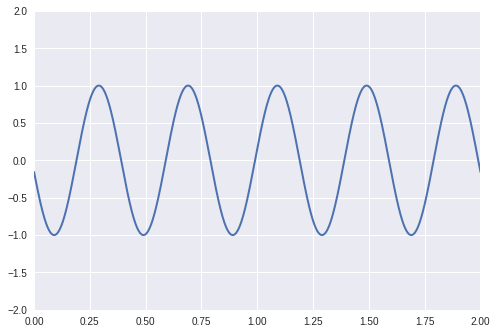

In [217]:
'''!pip install ffmpeg
#import ffmpeg'''
# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots()
ax.set_xlim(( 0, 2))
ax.set_ylim((-2, 2))

line, = ax.plot([], [], lw=2)

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return (line,)

# animation function. This is called sequentially
def animate(i):
    x = np.linspace(0, 2, 1000)
    y = np.sin(5 * np.pi * (x - 0.01 * i))
    line.set_data(x, y)
    return (line,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=20, blit=True)
HTML(anim.to_jshtml())

## EXAMPLE 2 FINITE DIFFERENCES

Seismic: 2D finite difference simulation of scalar wave propagation.

Difraction example in cylindrical wedge model. Based on:
R. M. Alford, K. R. Kelly and D. M. Boore -
Accuracy of finite-difference modeling of the acoustic wave equation.
Geophysics  1974


####First define the model and do the simulation 

In [0]:
#!pip install fatiando

from matplotlib import animation
from fatiando.seismic import wavefd
from fatiando.vis import mpl

# Set the parameters of the finite difference grid
shape = (270, 270)
ds = 10.  # spacing
area = [0, shape[0] * ds, 0, shape[1] * ds]
# Set the parameters of the finite difference grid
velocity = np.zeros(shape) + 2000.

velocity[:10, 0:] =     1800.
velocity[10:80, 0:] =   2000.
velocity[80:150, 0:] =  2300.
velocity[100:, 0:100] = 5000.
velocity[150:, 0:] =    3500.
velocity[250:, 0:] =    5500.

fc = 35.
sources = [wavefd.GaussSource(250 * ds, 1 * ds, area, shape, 1500., fc)]
dt = wavefd.scalar_maxdt(area, shape, np.max(velocity))
duration = 2.3
maxit = int(duration / dt)
stations = [[150 * ds, 1 * ds]]  # x, z coordinate of the seismometer
snapshots = 5  # every 3 iterations plots one
simulation = wavefd.scalar(
    velocity, area, dt, maxit, sources, stations, snapshots)


####Then do the animation

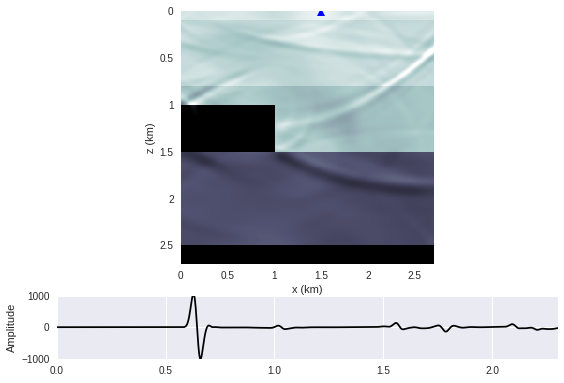

In [219]:
# This part makes an animation using matplotlibs animation API
background = (velocity - 3000) * 5 ** -1
fig = mpl.figure(figsize=(8, 6))
mpl.subplots_adjust(right=0.98, left=0.11, hspace=0.5, top=0.93)
mpl.subplot2grid((4, 3), (0, 0), colspan=3, rowspan=3)
wavefield = mpl.imshow(np.zeros_like(velocity), extent=area,
                       cmap=mpl.cm.bone_r, vmin=-300, vmax=300)
mpl.points(stations, '^b', size=8)
mpl.ylim(area[2:][::-1])
mpl.xlabel('x (km)')
mpl.ylabel('z (km)')
mpl.grid(False)
mpl.m2km()
mpl.subplot2grid((4, 3), (3, 0), colspan=3)
seismogram1, = mpl.plot([], [], '-k')
mpl.xlim(0, duration)
mpl.ylim(-1000, 1000)
mpl.ylabel('Amplitude')
times = np.linspace(0, dt * maxit, maxit)

# This function updates the plot every few timesteps
def animate(i):
    t, u, seismogram = simulation.next()
    seismogram1.set_data(times[:t + 1], seismogram[0][:t + 1])
    wavefield.set_array(background[::-1] + u[::-1])
    return wavefield, seismogram1

anim = animation.FuncAnimation(
    fig, animate, frames=maxit / snapshots, interval=1)
HTML(anim.to_jshtml())

##EXAMPLE 3 ZOEPPRITZ EQUATION

Various reflectivity algorithms.
:copyright: 2015 Agile Geoscience
:license: Apache 2.0

In [220]:
Image(url= "http://subsurfwiki.org/images/math/a/4/d/a4d088309091999358f83663a2996fd0.png")


In [221]:
Image(url= "http://subsurfwiki.org/thumb.php?f=Mode_conversion_p_wave.png&width=400")

First we define the scattering matrix

Full Zoeppritz solution, considered the definitive solution.
    Calculates the angle dependent p-wave reflectivity of an interface
    between two mediums.
    Written by: Wes Hamlyn
    :param vp1: The p-wave velocity of the upper medium.
    :param vs1: The s-wave velocity of the upper medium.
    :param rho1: The density of the upper medium.
    :param vp0: The p-wave velocity of the lower medium.
    :param vs0: The s-wave velocity of the lower medium.
    :param rho0: The density of the lower medium.
    :param theta1: A scalar  [degrees].
    :returns: a 4x4 array representing the scattering matrix
                at the incident angle theta1.

In [0]:
def scattering_matrix(vp1, vs1, rho1, vp0, vs0, rho0, theta1):
      # Make sure theta1 is an array
    theta1 = np.radians(np.array(theta1))
    if theta1.size == 1:
        theta1 = np.expand_dims(theta1, axis=1)

    # Set the ray paramter, p
    p = sin(theta1) / vp1  # ray parameter

    # Calculate reflection & transmission angles for Zoeppritz
    theta2 = np.arcsin(p * vp0)      # Trans. angle of P-wave
    phi1 = np.arcsin(p * vs1)     # Refl. angle of converted S-wave
    phi2 = np.arcsin(p * vs0)      # Trans. angle of converted S-wave

    # Matrix form of Zoeppritz Equations... M & N are matricies
    M = np.array([[-sin(theta1), -cos(phi1), sin(theta2), cos(phi2)],
                  [cos(theta1), -sin(phi1), cos(theta2), -sin(phi2)],
                  [2 * rho1 * vs1 * sin(phi1) * cos(theta1),
                   rho1 * vs1 * (1 - 2 * sin(phi1) ** 2),
                   2 * rho0 * vs0 * sin(phi2) * cos(theta2),
                   rho0 * vs0 * (1 - 2 * sin(phi2) ** 2)],
                  [-rho1 * vp1 * (1 - 2 * sin(phi1) ** 2),
                   rho1 * vs1 * sin(2 * phi1),
                   rho0 * vp0 * (1 - 2 * sin(phi2) ** 2),
                   -rho0 * vs0 * sin(2 * phi2)]], dtype='float')

    N = np.array([[sin(theta1), cos(phi1), -sin(theta2), -cos(phi2)],
                  [cos(theta1), -sin(phi1), cos(theta2), -sin(phi2)],
                  [2 * rho1 * vs1 * sin(phi1) * cos(theta1),
                   rho1 * vs1 * (1 - 2 * sin(phi1) ** 2),
                   2 * rho0 * vs0 * sin(phi2) * cos(theta2),
                   rho0 * vs0 * (1 - 2 * sin(phi2) ** 2)],
                  [rho1 * vp1 * (1 - 2 * sin(phi1) ** 2),
                   -rho1 * vs1 * sin(2 * phi1),
                   - rho0 * vp0 * (1 - 2 * sin(phi2) ** 2),
                   rho0 * vs0 * sin(2 * phi2)]], dtype='float')

    zoep = np.zeros((4, 4, M.shape[-1]))
    for i in range(M.shape[-1]):
        Mi = M[..., i]
        Ni = N[..., i]
        dt = np.dot(np.linalg.inv(Mi), Ni)
        zoep[..., i] = dt

    return zoep
  
def zoeppritz_element(vp1, vs1, rho1, vp0, vs0, rho0, theta1, element='PdPu'):
    """
    Returns any mode reflection coefficients from the Zoeppritz
    scattering matrix. Pass in the mode as element, e.g. 'PdSu' for PS.
    Wraps scattering_matrix().
    :returns: a vector of len(theta1) containing the reflectivity
             value corresponding to each angle.
    """
    elements = np.array([['PdPu', 'SdPu', 'PuPu', 'SuPu'],
                         ['PdSu', 'SdSu', 'PuSu', 'SuSu'],
                         ['PdPd', 'SdPd', 'PuPd', 'SuPd'],
                         ['PdSd', 'SdSd', 'PuSd', 'SuSd']])

    Z = scattering_matrix(vp1, vs1, rho1, vp0, vs0, rho0, theta1)

    return np.squeeze(Z[np.where(elements == element)])

def zoeppritz(vp1, vs1, rho1, vp0, vs0, rho0, theta1):
    '''
    Returns the PP reflection coefficients from the Zoeppritz
    scattering matrix.
    Wraps zoeppritz_element().
    :returns: a vector of len(theta1) containing the reflectivity
             value corresponding to each angle.
    '''
    return zoeppritz_element(vp1, vs1, rho1, vp0, vs0, rho0, theta1, 'PdPu')


Then we can test the equation with our parameters

In [223]:
vp1=2000
vs1=1200
rho1=2.3

vp2=2400
vs2=1500
rho2=2.5
angle=10

eportion=zoeppritz_element(vp1,vs1,rho1,vp2,vs2,rho2, angle, element='PdPu')

print('P wave down - P-wave up: %6.5f'% eportion)
print('\n')
print(scattering_matrix(vp1,vs1,rho1,vp2,vs2,rho2, angle))
 

P wave down - P-wave up: 0.12319


[[[ 0.12319168]
  [-0.03681081]
  [ 1.12715624]
  [-0.03865291]]

 [[-0.06074991]
  [-0.14134123]
  [ 0.06096537]
  [ 1.14980535]]

 [[ 0.87012533]
  [ 0.02851745]
  [-0.11868564]
  [ 0.04646744]]

 [[-0.04709502]
  [ 0.84888092]
  [ 0.07334048]
  [ 0.13683519]]]


##EXAMPLE 4 CONVOLUTION 1D

Here we visualize the convolution model.
We define a reflectivity series, which we convolve with a Ricker wavelet to get a seismic trace. This is done with and without noise

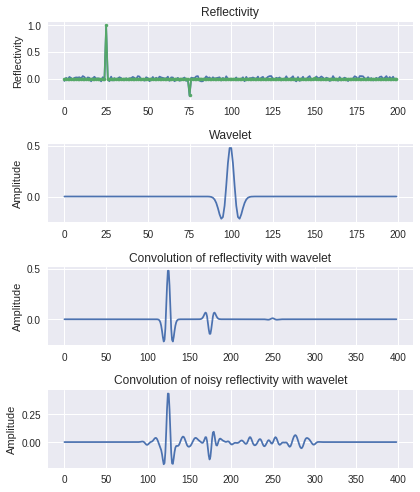

In [224]:
length=200
refl=np.zeros(length)
refl[25]=1
refl[75]=-.3
refl[150]=.02
noise=0.1
refln=refl-((np.random.random_sample(length)-0.5)*noise)

wav=sign.ricker(200, 3)
#wav=sign.daub(20)
conv1=sign.convolve(refl,wav)

plt.figure(1,figsize=(6, 7))
plt.subplot(4, 1, 1)
plt.plot(refln, '+-')
plt.plot(refl, '.-')
plt.title('Reflectivity')
plt.ylabel('Reflectivity')

plt.subplot(4, 1, 2)
plt.plot(wav)
plt.title('Wavelet')
plt.ylabel('Amplitude')

plt.subplot(4, 1, 3)
plt.title('Convolution of reflectivity with wavelet')
plt.plot(conv1)
plt.ylabel('Amplitude')

plt.subplot(4, 1, 4)
plt.title('Convolution of noisy reflectivity with wavelet')
plt.plot(sign.convolve(refln,wav))
plt.ylabel('Amplitude')
plt.tight_layout()
plt.show()

##EXAMPLE 4a WEDGE MODEL

**Python script to generate a zero-offset synthetic from a 3-layer wedge model.**
Created by:    Wes Hamlyn
Create Date:   19-Aug-2014
This script is provided without warranty of any kind.

####**    DEFINE MODELING PARAMETERS HERE**

3-Layer Model Parameters [Layer1, Layer2, Layer 3]

In [0]:
from matplotlib import gridspec

vp_mod = [2000.0, 3000.0, 4000.0]  # P-wave velocity (m/s)
vs_mod = [1200.0, 1300.0, 1400.0]  # S-wave velocity (m/s)
rho_mod= [1.95, 2.0, 2.05]         # Density (g/cc)

dz_min = 0.0   # Minimum thickness of Layer 2 (m)
dz_max = 70.0  # Maximum thickness of Layer 2 (m)
dz_step= 1.0   # Thickness step from trace-to-trace (normally 1.0 m)

#   Wavelet Parameters
wvlt_type = 'ricker'  # Valid values: 'ricker' or 'bandpass'
wvlt_length= 0.128 # Wavelet length in seconds
wvlt_phase = 0.0   # Wavelet phase in degrees
wvlt_scalar = 1.0  # Multiplier to scale wavelet amplitude (default = 1.0)
wvlt_cfreq = 40.0  # Ricker wavelet central frequency
f1 =  5.0          # Bandpass wavelet low truncation frequency
f2 = 10.0          # Bandpass wavelet low cut frequency
f3 = 50.0          # Bandpass wavelet high cut frequency
f4 = 65.0          # Bandpass wavelet high truncation frequency

#   Trace Parameters
tmin = 0.0
tmax = 0.5
dt = 0.0001 # changing this from 0.0001 can affect the display quality

#   Plot Parameters
min_plot_time = 0.22
max_plot_time = 0.35
excursion = 2


####**FUNCTIONS DEFINITIONS**


In [0]:
def ricker(cfreq, phase, dt, wvlt_length):
    '''
    Calculate a ricker wavelet
    
    Usage:
    ------
    t, wvlt = wvlt_ricker(cfreq, phase, dt, wvlt_length)
    
    cfreq: central frequency of wavelet in Hz
    phase: wavelet phase in degrees
    dt: sample rate in seconds
    wvlt_length: length of wavelet in seconds
    '''
    
    import numpy as np
    import scipy.signal as signal
    
    nsamp = int(wvlt_length/dt + 1)
    t_max = wvlt_length*0.5
    t_min = -t_max
    
    t = np.arange(t_min, t_max, dt)
    
    t = np.linspace(-wvlt_length/2, (wvlt_length-dt)/2, wvlt_length/dt)
    wvlt = (1.0 - 2.0*(np.pi**2)*(cfreq**2)*(t**2)) * np.exp(-(np.pi**2)*(cfreq**2)*(t**2))
    
    if phase != 0:
        phase = phase*np.pi/180.0
        wvlth = signal.hilbert(wvlt)
        wvlth = np.imag(wvlth)
        wvlt = np.cos(phase)*wvlt - np.sin(phase)*wvlth
    
    return t, wvlt


   
def calc_rc(vp_mod, rho_mod):
    '''
    rc_int = calc_rc(vp_mod, rho_mod)
    '''
    nlayers = len(vp_mod)
    nint = nlayers - 1
    rc_int = []
    for i in range(0, nint):
        buf1 = vp_mod[i+1]*rho_mod[i+1]-vp_mod[i]*rho_mod[i]
        buf2 = vp_mod[i+1]*rho_mod[i+1]+vp_mod[i]*rho_mod[i]
        buf3 = buf1/buf2
        rc_int.append(buf3)
    return rc_int

def calc_times(z_int, vp_mod):
    '''
    t_int = calc_times(z_int, vp_mod)
    '''
    nlayers = len(vp_mod)
    nint = nlayers - 1
    t_int = []
    for i in range(0, nint):
        if i == 0:
            tbuf = z_int[i]/vp_mod[i]
            t_int.append(tbuf)
        else:
            zdiff = z_int[i]-z_int[i-1]
            tbuf = 2*zdiff/vp_mod[i] + t_int[i-1]
            t_int.append(tbuf)
    return t_int

def digitize_model(rc_int, t_int, t):
    '''
    rc = digitize_model(rc, t_int, t)
    rc = reflection coefficients corresponding to interface times
    t_int = interface times
    t = regularly sampled time series defining model sampling
    '''
    import numpy as np
    nlayers = len(rc_int)
    nint = nlayers - 1
    nsamp = len(t)
    rc = list(np.zeros(nsamp,dtype='float'))
    lyr = 0
    for i in range(0, nsamp):
        if t[i] >= t_int[lyr]:
            rc[i] = rc_int[lyr]
            lyr = lyr + 1    
        if lyr > nint:
            break
    return rc

####**COMPUTATIONS BELOW HERE...**

In [0]:
nlayers = len(vp_mod)
nint = nlayers - 1
nmodel = int((dz_max-dz_min)/dz_step+1)
#   Generate wavelet
if wvlt_type == 'ricker':
    wvlt_t, wvlt_amp = ricker(wvlt_cfreq, wvlt_phase, dt, wvlt_length)
elif wvlt_type == 'bandpass':
    wvlt_t, wvlt_amp = wvlt_bpass(f1, f2, f3, f4, wvlt_phase, dt, wvlt_length)
#   Apply amplitude scale factor to wavelet (to match seismic amplitude values)
wvlt_amp = wvlt_scalar * wvlt_amp
#   Calculate reflectivities from model parameters
rc_int = calc_rc(vp_mod, rho_mod)


syn_zo = []
rc_zo = []
lyr_times = []
for model in range(0, nmodel):
    #   Calculate interface depths
    z_int = [500.0]
    z_int.append(z_int[0]+dz_min+dz_step*model)
   
    #   Calculate interface times
    t_int = calc_times(z_int, vp_mod)
    lyr_times.append(t_int)
    
    #   Digitize 3-layer model
    nsamp = int((tmax-tmin)/dt) + 1
    t = []
    for i in range(0,nsamp):
        t.append(i*dt)
        
    rc = digitize_model(rc_int, t_int, t)
    rc_zo.append(rc)
    
    #   Convolve wavelet with reflectivities
    syn_buf = np.convolve(rc, wvlt_amp, mode='same')
    syn_buf = list(syn_buf)
    syn_zo.append(syn_buf)
#    print ("finished step %i" % (model))
    
syn_zo = np.array(syn_zo)
t = np.array(t)
lyr_times = np.array(lyr_times)
lyr_indx = np.array(np.round(lyr_times/dt), dtype='int16')

# Use the transpose because rows are traces;
# columns are time samples.
tuning_trace = np.argmax(np.abs(syn_zo.T)) % syn_zo.T.shape[1]
tuning_thickness = tuning_trace * dz_step

####**Plotting Code**

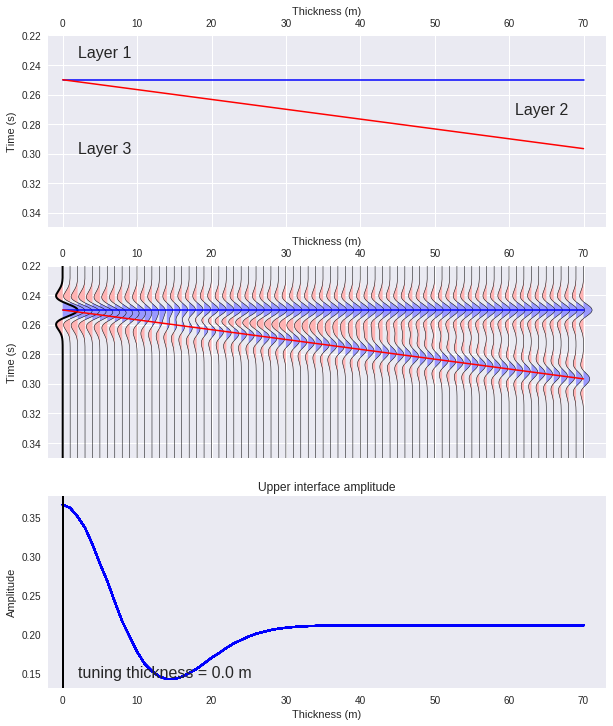

In [79]:
[ntrc, nsamp] = syn_zo.shape

fig = plt.figure(figsize=(10, 12))
fig.set_facecolor('white')

gs = gridspec.GridSpec(3, 1, height_ratios=[1, 1, 1])

ax0 = fig.add_subplot(gs[0])
ax0.plot(lyr_times[:,0], color='blue', lw=1.5)
ax0.plot(lyr_times[:,1], color='red', lw=1.5)
ax0.set_ylim((min_plot_time,max_plot_time))
ax0.invert_yaxis()
ax0.set_xlabel('Thickness (m)')
ax0.set_ylabel('Time (s)')
plt.text(2,
        min_plot_time + (lyr_times[0,0] - min_plot_time)/2.,
        'Layer 1',
        fontsize=16)
plt.text(dz_max/dz_step - 2,
        lyr_times[-1,0] + (lyr_times[-1,1] - lyr_times[-1,0])/2.,
        'Layer 2',
        fontsize=16,
        horizontalalignment='right')
plt.text(2,
        lyr_times[0,0] + (max_plot_time - lyr_times[0,0])/2.,
        'Layer 3',
        fontsize=16)
plt.gca().xaxis.tick_top()
plt.gca().xaxis.set_label_position('top')
ax0.set_xlim((-excursion, ntrc+excursion))

ax1 = fig.add_subplot(gs[1])
plot_vawig(ax1, syn_zo, t, excursion, highlight=tuning_trace)
ax1.plot(lyr_times[:,0], color='blue', lw=1.5)
ax1.plot(lyr_times[:,1], color='red', lw=1.5)
ax1.set_ylim((min_plot_time,max_plot_time))
ax1.invert_yaxis()
ax1.set_xlabel('Thickness (m)')
ax1.set_ylabel('Time (s)')

ax2 = fig.add_subplot(gs[2])
ax2.plot(syn_zo[:,lyr_indx[:,0]], color='blue')
ax2.set_xlim((-excursion, ntrc+excursion))
ax2.axvline(tuning_trace, color='k', lw=2)
ax2.grid()
ax2.set_title('Upper interface amplitude')
ax2.set_xlabel('Thickness (m)')
ax2.set_ylabel('Amplitude')
plt.text(tuning_trace + 2,
        plt.ylim()[0] * 1.1,
        'tuning thickness = {0} m'.format(str(tuning_thickness)),
        fontsize=16)
plt.savefig('figure_1.png')
plt.show()


##EXAMPLE 5 2D CONVOLUTION

Prerequisites.
Since in fatiando there are a few bugs concerning float-integer conversion, we have to explicitely code the three functions below.

####Functions

In [0]:
from fatiando.seismic import conv
from fatiando.vis import mpl
from scipy import interpolate 

def d2t(vel, model, dt, dz):
    """
    Convert depth property model to time model.
    Parameters:
    * vel : 2D-array
        Velocity values in the depth domain.
    * model : 2D-array
        Model values in the depth domain.
    * dt: float
        Sample time of the ricker wavelet and of the resulting seismogram, in
        general a value of 2.e-3 is used.
    * dz : float
        Length of square grid cells.
    * rho : 2D-array (optional)
        Density values for all the model, in depth domain.
    Returns:
    * model_t : 2D-array
        Property model in time domain.
    """
    err_message = "Velocity and model matrix must have the same dimension."
    assert vel.shape == model.shape, err_message
    # downsampled time rate to make a better interpolation
    n_samples, n_traces = [vel.shape[0], vel.shape[1]]
    dt_dwn = dt/10.
    if dt_dwn > dz/np.max(vel):
        dt_dwn = (dz/np.max(vel))/10.
    TWT = np.zeros((n_samples, n_traces))
    TWT[0, :] = 2*dz/vel[0, :]
    for j in range(1, n_samples):
        TWT[j, :] = TWT[j-1]+2*dz/vel[j, :]
    TMAX = max(TWT[-1, :])
    TMIN = min(TWT[0, :])
    TWT_rs = np.zeros(int(np.ceil(TMAX/dt_dwn)))
#    TWT_rs=TWT_rs.astype(int)
    for j in range(1, len(TWT_rs)):
        TWT_rs[j] = TWT_rs[j-1]+dt_dwn
    resmpl = int(dt/dt_dwn)
    model_t = _resampling(model, TMAX, TWT, TWT_rs, dt, dt_dwn, n_traces)
    return model_t

def _resampling(model, TMAX, TWT, TWT_rs, dt, dt_dwn, n_traces):
    """
    Resamples the input data to adjust it after time conversion with the chosen
    time sample rate, dt.

    Returns:

    * vel_l : 2D-array
        Resampled input data.

    """
    vel = np.ones((int(np.ceil(TMAX/dt_dwn)), n_traces))
    for j in range(0, n_traces):
        kk = np.ceil(TWT[0, j]/dt_dwn)
        lim = np.ceil(TWT[-1, j]/dt_dwn)-1
        kk=int(kk)
        lim=int(lim)
    # necessary do before resampling to have values in all points of time model
        tck = interpolate.interp1d(TWT[:, j], model[:, j])
        vel[kk:lim, j] = tck(TWT_rs[kk:lim])
    # the model is extended in time because of depth time conversion
        vel[lim:, j] = vel[lim-1, j]
    # because of time conversion, the values between 0 e kk need to be filed
        vel[0:kk, j] = model[0, j]
    # resampling from dt_dwn to dt
    vel_l = np.zeros((int(np.ceil(TMAX/dt)), n_traces))
    resmpl = int(dt/dt_dwn)
    vel_l[0, :] = vel[0, :]
    for j in range(0, n_traces):
        for jj in range(1, int(np.ceil(TMAX/dt))):
            vel_l[jj, j] = vel[resmpl*jj, j]
    return vel_l
  
def rickerw(f, dt):
    r"""
    Given a frequency and time sampling rate, outputs ricker function. The
    length of the function varies according to f and dt, in order for the
    ricker function starts and ends as zero. It is also considered that the
    functions is causal, what means it starts at time zero. To satisfy sampling
    and stability:
    .. math::
        f << \frac{1}{2 dt}.
    Here, we consider this as:
    .. math::
        f < 0.2 \frac{1}{2 dt}.
    Parameters:
    * f : float
        dominant frequency value in Hz
    * dt : float
        time sampling rate in seconds (usually it is in the order of ms)
    Returns:
    * ricker : float
      Ricker function for the given parameters.
    """
    assert f < 0.2*(1./(2.*dt)), "Frequency too high for the dt chosen."
    nw = 2.2/f/dt
    nw = 2*np.floor(nw/2)+1
    nc = np.floor(nw/2)
    ricker = np.zeros(int(nw))
    k = np.arange(1, nw+1)
    alpha = (nc-k+1)*f*dt*np.pi
    beta = alpha**2
    ricker = (1.-beta*2)*np.exp(-beta)
    return ricker

#### Model definition, synthetic and plot

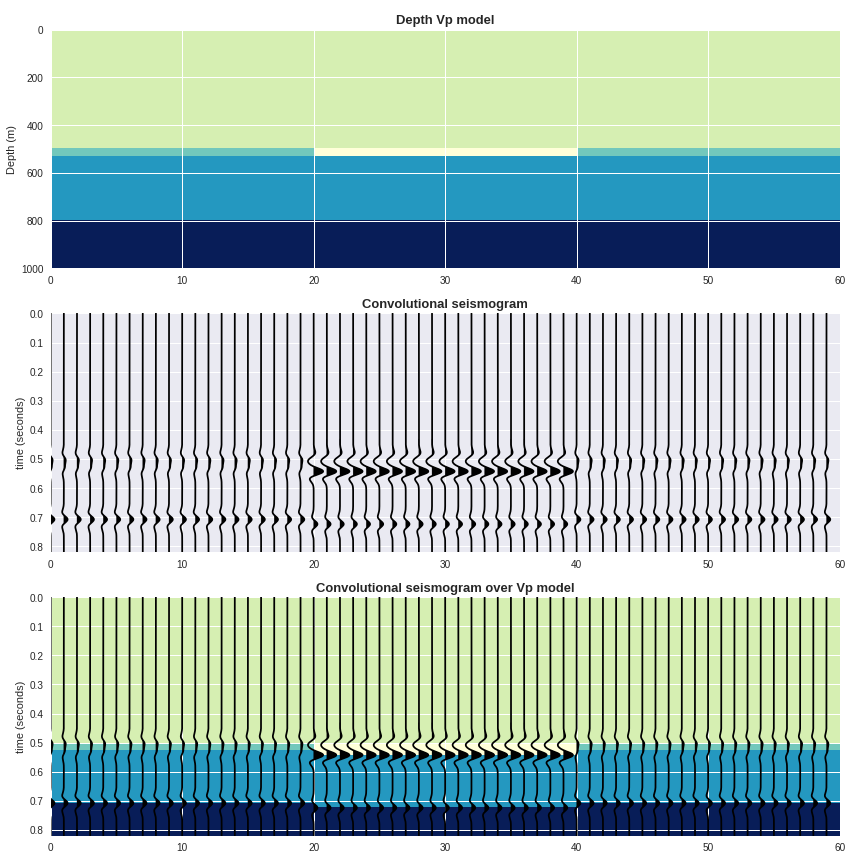

In [144]:
# model parameters
n_samples, n_traces = [1000, 60]
rock_grid = 2000.*np.ones((n_samples, n_traces))
rock_grid[500:, :20] =   2500.
rock_grid[500:, 20:40] = 1500.
rock_grid[500:, 40:] =   2500.
rock_grid[530:, :] =     3000.
rock_grid[800:, :] =     4000.

Wavelet_Center_Frequency = 15.
Scaler                   =  2.

# synthetic calculation
vel_l = d2t(rock_grid, rock_grid, dt=2.e-3, dz=1.)
rho_l = np.ones(np.shape(vel_l))
rc = conv.reflectivity(vel_l, rho_l)
synt = conv.convolutional_model(rc, Wavelet_Center_Frequency, rickerw, dt=2.e-3)

# plot input model
plt.figure(figsize=(12,12))
plt.subplot(3, 1, 1)
plt.ylabel('Depth (m)')
plt.title("Depth Vp model", fontsize=13, family='sans-serif', weight='bold')
plt.imshow(rock_grid, extent=[0, n_traces, n_samples, 0],
           cmap=mpl.pyplot.cm.YlGnBu, aspect='auto', origin='upper')

# plot resulted seismogram using wiggle
plt.subplot(3, 1, 2)
mpl.seismic_wiggle(Scaler*synt, dt=2.e-3)
#mpl.seismic_image(synt, dt=2.e-3, cmap=mpl.pyplot.cm.jet, aspect='auto')
plt.ylabel('time (seconds)')
plt.title("Convolutional seismogram", fontsize=13, family='sans-serif',
          weight='bold')

# plot resulted seismogram using wiggle over Vp model
plt.subplot(3, 1, 3)
mpl.seismic_image(vel_l, dt=2.e-3, cmap=mpl.pyplot.cm.YlGnBu, aspect='auto')
mpl.seismic_wiggle(Scaler*synt, dt=2.e-3)
plt.ylabel('time (seconds)')
plt.title("Convolutional seismogram over Vp model", fontsize=13,
          family='sans-serif', weight='bold')
plt.tight_layout()
plt.figlegend()
plt.show()

##EXAMPLE 6 FOURIER TRANSFORM

['0.000', '-0.346', '1.379', '17.068', '39.897', '38.524', '6.957']
['-30.719', '-49.763', '-38.893', '-11.586', '4.060', '0.166', '-6.308']
['-4.112', '0.427', '0.880', '-0.312', '-0.029', '0.817', '0.885']
['0.738', '1.015', '1.295', '1.199', '1.154', '1.346', '1.452']
['1.437', '1.439', '1.553', '1.681', '1.693', '1.729', '1.802']
['1.841', '1.942', '2.026', '2.100', '2.164', '2.151', '2.138']
['2.085', '2.063', '2.079', '2.107', '2.063', '1.877', '1.544']
['1.165', '0.903', '0.682', '0.446', '0.184', '-0.079', '-0.223']
['-0.105', '0.062', '0.082', '0.007', '-0.210', '-0.371', '-0.468']
['-0.645', '-0.897', '-1.240', '-1.576', '-1.875', '-2.099', '-2.203']
['-2.086', '-1.745', '-1.321', '-0.891', '-0.615', '-0.486', '-0.531']
['-0.703', '-0.975', '-1.281', '-1.392', '-1.322', '-1.153', '-0.871']
['-0.612', '-0.389', '-0.146', '-0.007', '0.051', '-0.005', '-0.102']
['-0.125', '-0.103', '-0.014', '0.084', '0.118', '0.143', '0.200']
['0.226', '0.303', '0.369', '0.399', '0.446', '0.483

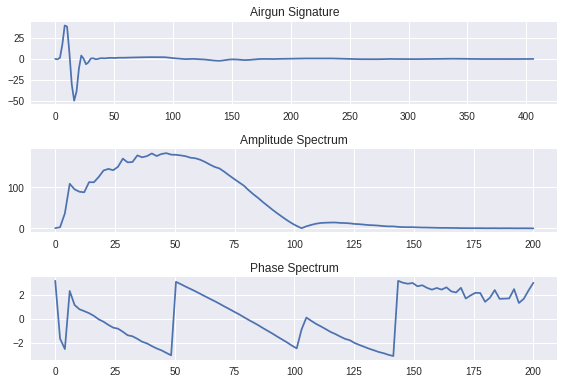

In [146]:
f=open('FarField.dat','r')
i=0;j=0;imax=0
size=len(f.read());dat=np.zeros(size);f.seek(0)

for line in f:
    line = line.split()
    print(line)
    i=0
    while i < len(line):
        dat[j*len(line)+i]=float(line[i])
        i+=1
        if imax<i:
            imax=i
#        print(j,i,dat[j*len(line)+i-1])
    j+=1
f.close

data=np.zeros(j*imax)
data[0:j*imax]=dat[0:j*imax]
del dat,i,j,imax,size,line

ampl=np.abs(np.fft.fft(data))
phase=np.angle(np.fft.fft(data))

fig = plt.figure()
ax1 = fig.add_subplot(311)
ax1.grid(True)
plt.plot(np.linspace(0,np.size(data)*2,np.size(data)),data)
plt.title('Airgun Signature')
ax1 = fig.add_subplot(312)
ax1.grid(True)
plt.plot(np.linspace(0,200,100),ampl[0:100])
plt.title('Amplitude Spectrum')
ax1 = fig.add_subplot(313)
ax1.grid(True)
plt.plot(np.linspace(0,200,100),phase[0:100])
plt.title('Phase Spectrum')
#datazero=np.fft.ifftshift(ampl)
plt.tight_layout()
plt.show()

## EXAMPLE 7 FOURIER TRANSFORM 2

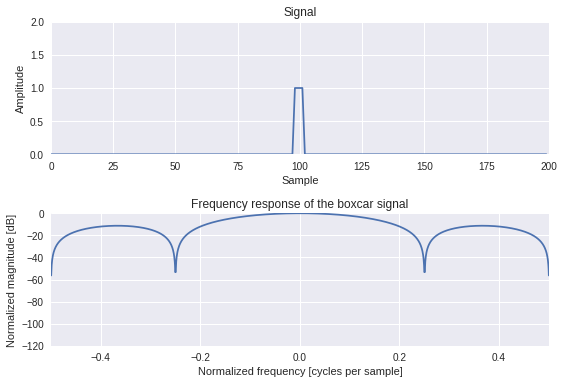

In [166]:
sig = np.zeros(200)
DT=4; SamplingRate=4

sig[(len(sig)/2-(SamplingRate/2)):(len(sig)/2+(SamplingRate/2))] = 1
#sig[20:24]=0.5
#sig[150:154]=0.5

A = fft(sig, 2048) / (len(sig)/2.0)
freq = np.linspace(-0.5, 0.5, len(A))

response = 20 * np.log10(np.abs(fftshift(A / abs(A).max())))

fig = plt.figure()
plt.subplot(211)
plt.plot(sig,'-x')
plt.axis([0, len(sig), 0, 2])
plt.title("Signal")
plt.ylabel("Amplitude")
plt.xlabel("Sample")

plt.subplot(212)
plt.plot(freq, response)
plt.axis([-0.5, 0.5, -120, 0])
plt.title("Frequency response of the boxcar signal")
plt.ylabel("Normalized magnitude [dB]")
plt.xlabel("Normalized frequency [cycles per sample]")
plt.tight_layout()

##EXAMPLE 8 SAMPLING - ALIASING

Aliasing is a misterious word, although we experience it also in daily live, whenever we are concerned with sampling. Sampling is not limited to seismic, but is present in all analog-to-digital conversions..

**Here an example from photography**

In [176]:
Image(url= "https://d2w9rnfcy7mm78.cloudfront.net/1980234/display_07c82227bad34e65e1e7247b9ea56614.jpg")

**And one from video**

In [177]:
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/ByTsISFXUoY?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>')

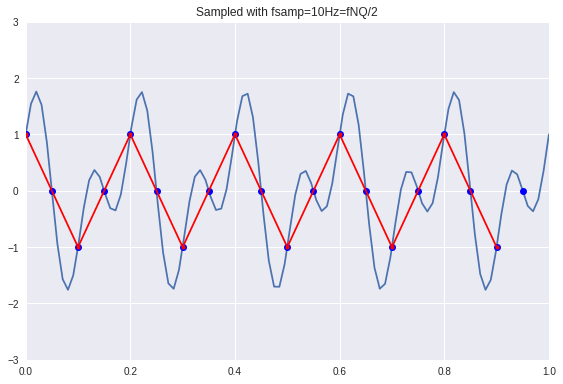

In [178]:
from numpy import linspace,sin,cos,pi,ceil,floor,arange
from pylab import plot,show,axis

# sampling a signal badlimited to 40 Hz 
# with a sampling rate of 800 Hz
fig=plt.figure(7)
f = 10;  # Hz
tmin = 0;
tmax = 1;
t = linspace(tmin, tmax, 100);
x = cos(2*pi*t*f/2) + sin(2*pi*f*t); # signal sampling
plot(t, x)
plt.title("Continuous signal fmax=10Hz")
# sampling the signal with a sampling rate of 20 Hz
# in this case, we are using the Nyquist rate.
T = 1/20.0;
nmin = ceil(tmin / T);
nmax = floor(tmax / T);
n = arange(nmin,nmax);
x1 = cos(2*pi*n*T*f/2) + sin(2*pi*f*n*T);
plot(n*T, x1, 'bo')
plt.title("Sampled with fsamp=10Hz=fNQ/2")
# sampling the signal with a sampling rate of 35 Hz
# note that 35 Hz is under the Nyquist rate.
T = 1/10.0;
nmin = ceil(tmin / T);
nmax = floor(tmax / T);
n = arange(nmin,nmax);
x2 = cos(2*pi*n*T*f/2) + sin(2*pi*f*n*T);
plot(n*T, x2, '-r.',markersize=8)
plt.tight_layout()
axis([0, 1, -3, 3])
show()

##EXAMPLE 9 VIBROSEIS PRINCIPLE

#### Import TF representations 
Copyright © 2015 jaidev <jaidev@newton>

In [0]:
class BaseTFRepresentation(object):

    isaffine = False

    def __init__(self, signal, **kwargs):
        """Create a base time-frequency representation object.

        :param signal: Signal to be analyzed.
        :param **kwargs: Other arguments required for performing the analysis.
        :type signal: array-like
        :return: BaseTFRepresentation object
        :rtype:
        """
        if (signal.ndim == 2) and (1 in signal.shape):
            signal = signal.ravel()
        self.signal = signal
        timestamps = kwargs.get('timestamps')
        if timestamps is None:
            timestamps = np.arange(signal.shape[0])
        self.ts = self.timestamps = timestamps
        n_fbins = kwargs.get('n_fbins')
        if n_fbins is None:
            n_fbins = signal.shape[0]
        self.n_fbins = n_fbins
        fwindow = kwargs.get('fwindow')
        if fwindow is None:
            fwindow = self._make_window()
        self.fwindow = fwindow
        if self.n_fbins % 2 == 0:
            freqs = np.hstack((np.arange(self.n_fbins / 2),
                               np.arange(-self.n_fbins / 2, 0)))
        else:
            freqs = np.hstack((np.arange((self.n_fbins - 1) / 2),
                               np.arange(-(self.n_fbins - 1) / 2, 0)))
        self.freqs = freqs.astype(float) / self.n_fbins
        self.tfr = np.zeros((self.n_fbins, self.ts.shape[0]), dtype=complex)

    def _get_spectrum(self):
        if not self.isaffine:
            return np.fft.fftshift(np.abs(np.fft.fft(self.signal)) ** 2)
        nf2 = self.tfr.shape[0]
        spec = np.abs(np.fft.fft(self.signal[self.ts.min():(self.ts.max() + 1)],
                                 2 * nf2)) ** 2
        return spec[:nf2]

    def _make_window(self):
        """Make a Hamming window function.

        The window function has a length equal to quarter of the length of the
        input signal.
        :return: Hamming window function.
        :rtype: array-like
        """

        h = np.floor(self.n_fbins / 4.0)
        h += 1 - np.remainder(h, 2)
        from scipy import hamming
        fwindow = hamming(int(h))
        # No need to normalize the window
        # fwindow = fwindow / np.linalg.norm(fwindow)
        return fwindow

    def _plot_tfr(self, ax, kind, extent, contour_x=None, contour_y=None,
                  levels=None, show_tf=True, cmap=plt.cm.gray):
        if kind == "cmap":
            ax.imshow(self.tfr, cmap=cmap, origin="bottomleft", extent=extent,
                      aspect='auto')
        elif kind == "contour":
            if contour_x is None:
                contour_x = self.ts
            if contour_y is None:
                if show_tf:
                    if self.isaffine:
                        contour_y = np.linspace(self.fmin, self.fmax, self.n_voices)
                    else:
                        contour_y = np.linspace(0, 0.5, self.signal.shape[0])
                else:
                    contour_y = np.linspace(0, 0.5, self.tfr.shape[0])
            contour_x, contour_y = np.meshgrid(contour_x, contour_y)
            if levels is not None:
                ax.contour(contour_x, contour_y, self.tfr, levels)
            else:
                if self.isaffine:
                    maxi = np.amax(self.tfr)
                    mini = max(np.amin(self.tfr), maxi * self._viz_threshold)
                    levels = np.linspace(mini, maxi, 65)
                    ax.contour(contour_x, contour_y, self.tfr, levels=levels)
                else:
                    ax.contour(contour_x, contour_y, self.tfr)

    def _annotate_tfr(self, ax):
        ax.grid(True)
        ax.set_xlabel("Time")
        ax.set_ylabel("Normalized Frequency")
        ax.set_title(self.name.upper())
        ax.yaxis.set_label_position("right")

    def _plot_signal(self, ax):
        ax.plot(np.real(self.signal))

    def _annotate_signal(self, ax):
        ax.set_xticklabels([])
        ax.set_xlim(0, self.signal.shape[0])
        ax.set_ylabel('Real part')
        ax.set_title('Signal in time')
        ax.grid(True)

    def _plot_spectrum(self, ax, freq_x, freq_y):
        k = int(np.floor(self.signal.shape[0] / 2.0))
        if freq_x is None:
            freq_x = self._get_spectrum()[::-1][:k]
        if freq_y is None:
            if self.isaffine:
                freq_y = self.freqs
            else:
                freq_y = np.arange(k)
        ax.plot(freq_x, freq_y)
        if not self.isaffine:
            ax.set_ylim(0, freq_y.shape[0] - 1)
        else:
            ax.set_ylim(freq_y[0], freq_y[-1])

    def _annotate_spectrum(self, ax):
        ax.set_ylabel('Spectrum')
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        ax.grid(True)
        if not self.isaffine:
            ax.invert_xaxis()
            ax.invert_yaxis()

    def plot(self, ax=None, kind='cmap', show=True, default_annotation=True,
             show_tf=False, scale="linear", threshold=0.05, **kwargs):
        """Visualize the time frequency representation.

        :param ax: Axes object to draw the plot on.
        :param kind: One of "cmap" (default), "contour".
        :param show: Whether to call ``plt.show()``.
        :param default_annotation: Whether to make default annotations for the
            plot. Default annotations consist of setting the X and Y axis labels to
            "Time" and "Normalized Frequency" respectively, and setting the title
            to the name of the particular time-frequency distribution.
        :param show_tf: Whether to show the signal and it's spectrum alongwith
            the plot. In this is True, the ``ax`` argument is ignored.
        :param **kwargs: Parameters to be passed to the plotting function.
        :type ax: matplotlib.axes.Axes object
        :type kind: str
        :type show: bool
        :type default_annotation: bool
        :return: None
        :rtype: None
        """
        self._viz_threshold = threshold

        extent = kwargs.pop('extent', None)
        if extent is None:
            extent = [self.ts.min(), self.ts.max(), self.freqs.min(),
                      self.freqs.max()]
        contour_x = kwargs.pop('contour_x', None)
        contour_y = kwargs.pop('contour_y', None)
        levels = kwargs.pop('levels', None)
        freq_x = kwargs.pop('freq_x', None)
        freq_y = kwargs.pop('freq_y', None)
        cmap = kwargs.pop("cmap", plt.cm.gray)

        if show_tf:
            fig, axTF = plt.subplots(figsize=(10, 8))
            self._plot_tfr(axTF, kind, extent, contour_x, contour_y, levels,
                           show_tf, cmap=cmap)
            from mpl_toolkits.axes_grid1 import make_axes_locatable
            divider = make_axes_locatable(axTF)

            axTime = divider.append_axes("top", 1.2, pad=0.5)
            self._plot_signal(axTime)

            axSpec = divider.append_axes("left", 1.2, pad=0.5)
            self._plot_spectrum(axSpec, freq_x, freq_y)

            if default_annotation:
                self._annotate_tfr(axTF)
                self._annotate_signal(axTime)
                self._annotate_spectrum(axSpec)
        else:
            if (ax is None) and (kind != "surf"):
                fig = plt.figure()
                ax = fig.add_subplot(111)
            if kind == "cmap":
                ax.imshow(self.tfr,
                          aspect='auto', origin='bottomleft', extent=extent,
                          **kwargs)
            elif kind == "surf":
                from mpl_toolkits.mplot3d import Axes3D
                fig = plt.figure()
                ax = fig.gca(projection="3d")
                x = np.arange(self.signal.shape[0])
                y = np.linspace(0, 0.5, self.signal.shape[0])
                X, Y = np.meshgrid(x, y)
                ax.plot_surface(X, Y, np.abs(self.tfr), cmap=plt.cm.jet)
                if default_annotation:
                    ax.set_zlabel("Amplitude")
            elif kind == "wireframe":
                from mpl_toolkits.mplot3d import Axes3D  # NOQA
                ax = fig.gca(projection="3d")
                x = np.arange(self.signal.shape[0])
                y = np.linspace(0, 0.5, self.signal.shape[0])
                X, Y = np.meshgrid(x, y)
                ax.plot_wireframe(X, Y, np.abs(self.tfr), cmap=plt.cm.jet,
                                  rstride=3, cstride=3)
            else:
                t, f = np.meshgrid(self.ts, np.linspace(0, 0.5, self.tfr.shape[0]))
                ax.contour(t, f, self.tfr, **kwargs)
            if default_annotation:
                grid = kwargs.get('grid', True)
                ax.grid(grid)
                ax.set_xlabel("Time")
                ax.set_ylabel("Normalized Frequency")
                ax.set_title(self.name.upper())
        if show:
            plt.show()


def fmlin(n_points, fnormi=0.0, fnormf=0.5, t0=None):
    """
    Generate a signal with linear frequency modulation.

    :param n_points: number of points
    :param fnormi: initial normalized frequency
    :param fnormf: final normalized frequency
    :param t0: time center
    :type n_points: int
    :type fnormi: float
    :type fnormf: float
    :type t0: float
    :return: The modulated signal, and the instantaneous amplitude law.
    :rtype: tuple(array-like)
    :Examples:
    >>> from tftb.generators import amgauss
    >>> z = amgauss(128, 50, 40) * fmlin(128, 0.05, 0.3, 50)[0]
    >>> plot(real(z)) #doctest: +SKIP

    .. plot:: docstring_plots/generators/frequency_modulated/fmlin.py
    """
    if t0 is None:
        t0 = round(n_points / 2.0)

    if n_points <= 0:
        raise TypeError

    elif (abs(fnormi) > 0.5) or (abs(fnormf) > 0.5):
        raise TypeError

    else:
        y = np.arange(1, n_points + 1)
        y = fnormi * (y - t0) + ((fnormf - fnormi) / (2.0 * (n_points - 1))) * \
            ((y - 1) ** 2 - (t0 - 1) ** 2)
        y = np.exp(1j * 2.0 * np.pi * y)
        y = y / y[int(t0) - 1]
        iflaw = np.linspace(fnormi, fnormf, n_points)
        return y, iflaw

class WignerVilleDistribution(BaseTFRepresentation):

    name = "wigner-ville"

    def run(self):
        tausec = round(self.n_fbins / 2.0)
        winlength = tausec - 1
        taulens = np.min(np.c_[np.arange(self.signal.shape[0]),
                               self.signal.shape[0] - np.arange(self.signal.shape[0]) - 1,
                         winlength * np.ones(self.ts.shape)], axis=1)
        conj_signal = np.conj(self.signal)
        for icol in range(self.ts.shape[0]):
            taumax = taulens[icol]
            tau = np.arange(-taumax, taumax + 1).astype(int)
            indices = np.remainder(self.n_fbins + tau, self.n_fbins).astype(int)
            self.tfr[indices, icol] = self.signal[icol + tau] * \
                conj_signal[icol - tau]
            if (icol <= self.signal.shape[0] - tausec) and (icol >= tausec + 1):
                self.tfr[tausec, icol] = (self.signal[icol + tausec, 0] *
                                          np.conj(self.signal[icol - tausec, 0])) + \
                    (self.signal[icol - tausec, 0] * conj_signal[icol + tausec, 0])
        self.tfr = np.fft.fft(self.tfr, axis=0)
        self.tfr = np.real(self.tfr)
        self.freqs = 0.5 * np.arange(self.n_fbins, dtype=float) / self.n_fbins
        return self.tfr, self.ts, self.freqs

    def plot(self, kind='cmap', threshold=0.05, sqmod=False, **kwargs):
        scale = kwargs.pop("scale", "linear")
        if scale == "log":
            maxi = np.amax(self.tfr)
            mini = max(np.amin(self.tfr), maxi * threshold)
            levels = np.logspace(np.log10(mini), np.log10(maxi), 65)
            kwargs['levels'] = levels
        if sqmod:
            self.tfr = np.abs(self.tfr) ** 2
        else:
            self.tfr = np.abs(self.tfr)
        _threshold = np.amax(self.tfr) * threshold
        self.tfr[self.tfr <= _threshold] = 0.0
        super(WignerVilleDistribution, self).plot(kind=kind, threshold=threshold,
                                                  **kwargs)


####Calculations and plotting

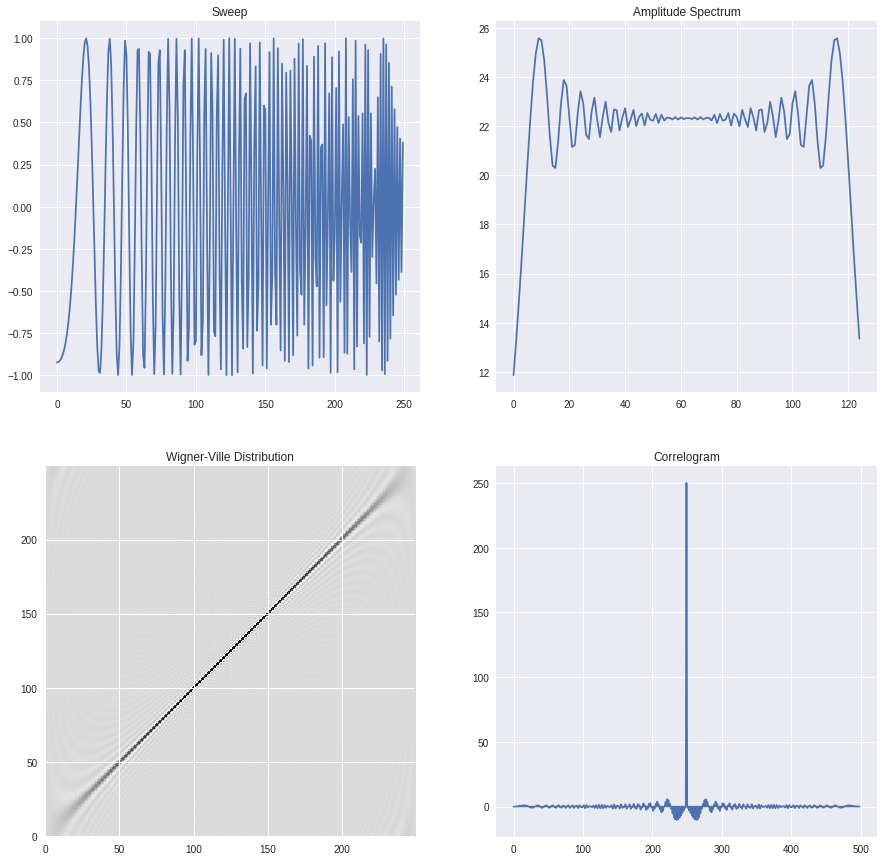

In [214]:
n_points = 250
fmin, fmax = 0.0, 0.5
sweep, _ = fmlin(n_points, fmin, fmax)
acsweep=sign.correlate(sweep,sweep)

wvd = WignerVilleDistribution(sweep)
sweepTF=wvd.run()

fig=plt.figure(figsize=(15,15))
ax1 = fig.add_subplot(221)
plt.plot(np.real(sweep))
ax1.set_title('Sweep')
ax2 = fig.add_subplot(222)
plt.plot(abs(fft(sweep)[0:125]))
ax2.set_title('Amplitude Spectrum')
ax3 = fig.add_subplot(223)
ax3.set_title('Wigner-Ville Distribution')
plt.imshow(sweepTF[0])
plt.gca().invert_yaxis()
ax4 = fig.add_subplot(224)
ax4.set_title('Correlogram')
plt.plot(acsweep)
plt.show()

##EXAMPLE 10 SOURCE/RECEIVER ARRAY

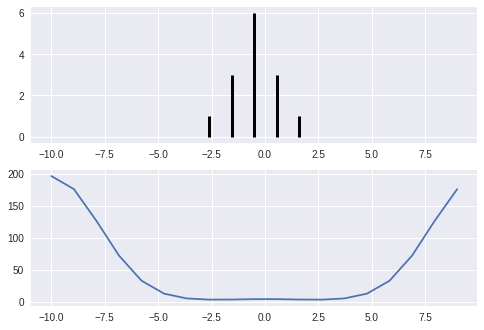

In [179]:
comb = [0,0,0,0,0,0,0,1,3,6,3,1,0,0,0,0,0,0,0]
x=np.linspace(-len(comb)/2,len(comb)/2,len(comb))
y=np.asarray(comb)

fftcomb=np.abs(np.fft.fft(comb))**2

fig = plt.figure(2)
ax1 = fig.add_subplot(211)
ax1.grid(True)
plt.vlines(x,[0],comb,lw=3)

ax1 = fig.add_subplot(212)
ax1.grid(True)
plt.plot(x,fftcomb)
plt.show(2)

##EXAMPLE 11 STACKING

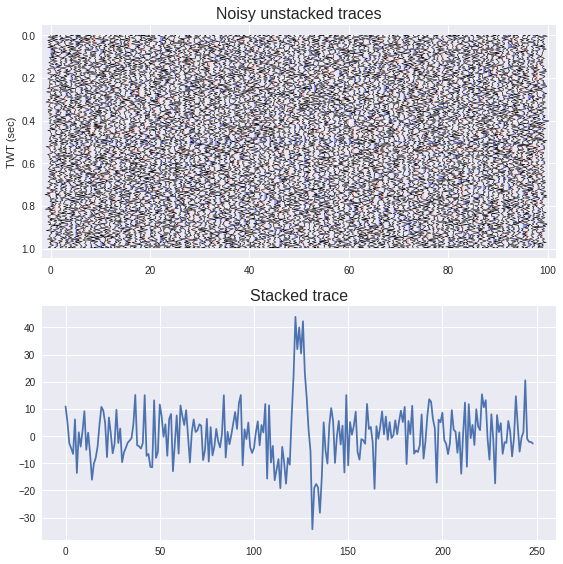

In [180]:
n=200
m=50
nt=100
noise_level=.7
REFL = np.zeros((nt,n))
REFL[:,int(n/2)] = 1
WAV   = sign.ricker(m,5)
TRACE = np.zeros((nt,n+m-1))
TIME = np.linspace(0,0.004*TRACE.shape[1],TRACE.shape[1])

for i in range(len(TRACE[:,1])):
    TRACE[i,:] = sign.convolve(REFL[i],WAV)
    TRACE[i,:] = TRACE[i,:] + np.random.normal(0,noise_level,len(TRACE[1,:]))

#ax.fill_betweenx(TRACE,color='k')
fig = plt.figure(figsize=(8, 8))
ax1 = fig.add_subplot(211)
ax1.set_title('Noisy unstacked traces', fontsize=16)
plot_vawig(ax1,TRACE,TIME,1.7)
ax1.set_ylabel('TWT (sec)')
ax1.xaxis.tick_bottom()
ax1.xaxis.set_label_position('bottom')
#ax1.set_ylim((min_plot_time,max_plot_time))

STACK = np.zeros(TRACE.shape[1])
for i in range(TRACE.shape[1]):
    STACK[i] = TRACE[:,i].sum()
ax2 = fig.add_subplot(212)
ax2.set_title('Stacked trace', fontsize=16)
ax2.plot (STACK)
plt.tight_layout()

##EXAMPLE 12 BIN size estimation

Required bin size can be estimated from expected dip and velocity via a simple formula

$ Bin=Vint/4*fmax*sin(dip) $

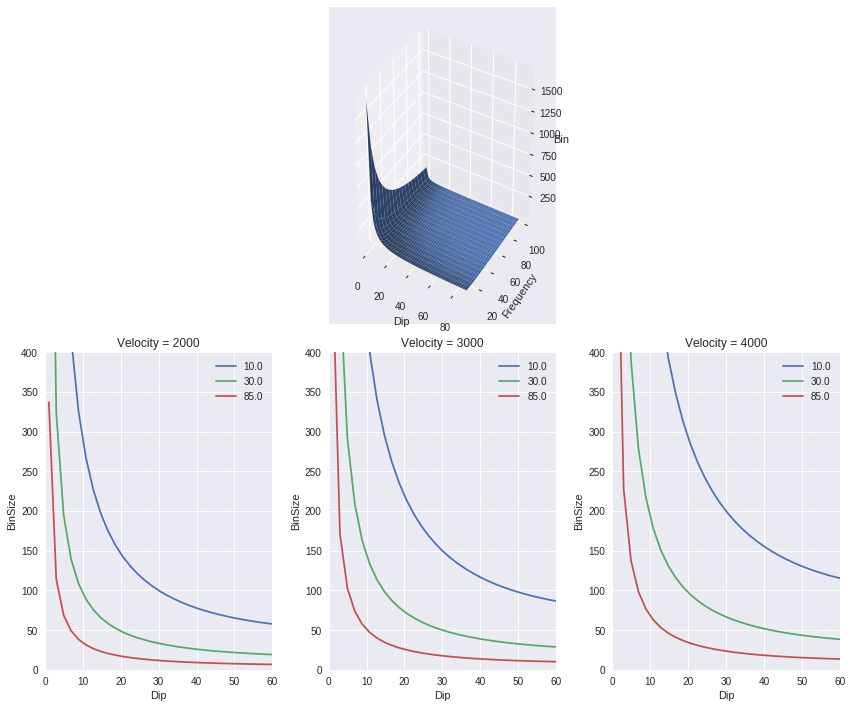

In [185]:
from mpl_toolkits.mplot3d import Axes3D

# Model definition
vel=np.linspace(1000,4000,31)
f=np.linspace(10,100,19)
dip=np.linspace(1,89,46)

# This is the only calculation
bin=np.empty((np.size(vel),np.size(f),np.size(dip)))

for i in range(len(vel)):
    for j in range(len(f)):
        for k in range(len(dip)):
            bin[i,j,k]=vel[i]/(4*f[j]*np.sin(math.radians(dip[k])))

#The rest is plotting
fig = plt.figure(figsize=(12, 10))
ax1 = fig.add_subplot((232), projection='3d')
X, Y = np.meshgrid(dip, f)
ax1.plot_surface(X, Y, bin[2,:,:])
ax1.set_xlabel('Dip')
ax1.set_ylabel('Frequency')
ax1.set_zlabel('Bin')

ax2 = fig.add_subplot(234)
ax2.plot(dip,bin[10,0,:],label=f[0])
ax2.plot(dip,bin[10,4,:],label=f[4])
ax2.plot(dip,bin[10,15,:],label=f[15])
ax2.set_xlim([0,60])
ax2.set_ylim([0,400])
ax2.legend()
ax2.set_xlabel('Dip')
ax2.set_ylabel('BinSize')
ax2.grid()
plt.title('Velocity = %4.0f' % vel[10])
plt.grid(True)

ax3 = fig.add_subplot(235)
ax3.plot(dip,bin[20,0,:],label=f[0])
ax3.plot(dip,bin[20,4,:],label=f[4])
ax3.plot(dip,bin[20,15,:],label=f[15])
ax3.set_xlim([0,60])
ax3.set_ylim([0,400])
ax3.legend()
ax3.set_xlabel('Dip')
ax3.set_ylabel('BinSize')
ax3.grid()
plt.title('Velocity = %4.0f' % vel[20])
plt.grid(True)

ax4 = fig.add_subplot(236)
ax4.plot(dip,bin[30,0,:],label=f[0])
ax4.plot(dip,bin[30,4,:],label=f[4])
ax4.plot(dip,bin[30,15,:],label=f[15])
ax4.set_xlim([0,60])
ax4.set_ylim([0,400])
ax4.legend()
ax4.set_xlabel('Dip')
ax4.set_ylabel('BinSize')
ax4.grid()
plt.title('Velocity = %4.0f' % vel[30])
plt.grid(True)
plt.tight_layout()
plt.show()

##EXAMPLE 13 NMO

The NMO equation is $$T²=T0²+X²/V²$$

However, if we take the wrong V we may over- or undercorrect our records.

This is what we show here.


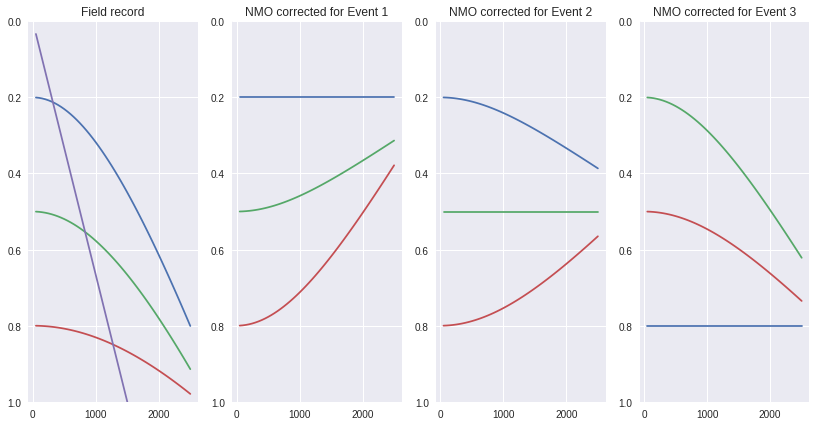

In [205]:
# First we define our model
x    = np.linspace(50,2500,50)
t    = np.linspace(0,2,1001)

# Then we define our reflection events
t1   = .200
t2   = .500
t3   = .800
vnmo1 = 2000
vnmo2 = 2500
vnmo3 = 4000
vlin  = 1500

tlin  = 0  + x/vlin
tnmo1 = t1 + ((1 + (x/vnmo1)**2)**0.5-1)
tnmo2 = t2 + ((1 + (x/vnmo2)**2)**0.5-1)
tnmo3 = t3 + ((1 + (x/vnmo3)**2)**0.5-1)

# Then we apply NMO correction with correct and wrong velocities
tdnmo1  = tnmo1 - ((1 + (x/vnmo1)**2)**0.5-1)
tdnmo21 = tnmo2 - ((1 + (x/vnmo1)**2)**0.5-1)
tdnmo31 = tnmo3 - ((1 + (x/vnmo1)**2)**0.5-1)

tdnmo2  = tnmo2 - ((1 + (x/vnmo2)**2)**0.5-1)
tdnmo12 = tnmo1 - ((1 + (x/vnmo2)**2)**0.5-1)
tdnmo32 = tnmo3 - ((1 + (x/vnmo2)**2)**0.5-1)

tdnmo3  = tnmo3 - ((1 + (x/vnmo3)**2)**0.5-1)
tdnmo13 = tnmo1 - ((1 + (x/vnmo3)**2)**0.5-1)
tdnmo23 = tnmo2 - ((1 + (x/vnmo3)**2)**0.5-1)

# Finally we plot the results
fig = plt.figure(figsize=(14, 7))
ax1=fig.add_subplot(141)
ax1.plot(x,tnmo1,x,tnmo2,x,tnmo3,x,tlin)
ax1.set_ylim([0,1.])
ax1.invert_yaxis()
ax1.set_title("Field record")

ax2=fig.add_subplot(142)
ax2.plot(x,tdnmo1,x,tdnmo21,x,tdnmo31)
ax2.set_ylim([0,1.])
ax2.invert_yaxis()
ax2.set_title("NMO corrected for Event 1")

ax3=fig.add_subplot(143)
ax3.plot(x,tdnmo12,x,tdnmo2,x,tdnmo32)
ax3.set_ylim([0,1.])
ax3.invert_yaxis()
ax3.set_title("NMO corrected for Event 2")

ax4=fig.add_subplot(144)
ax4.plot(x,tdnmo3,x,tdnmo13,x,tdnmo23)
ax4.set_ylim([0,1.])
ax4.invert_yaxis()
ax4.set_title("NMO corrected for Event 3")
plt.show()